In [1]:
import os, cv2, glob, shutil, random, re
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np
import pandas as pd

## EDA

In [2]:
upString = ['908', '910', '913', '914', '93F', '940', '947', '948', '94B', '94C']
lowString = ['941', '942']
numString = ['0966', '0967', '0968', '0969', '096A', '096B', '096C', '096D', '096E', '096F']

In [3]:
path = "SegregatedCALAM/"
folderNames = [[], [], []]
for tem in glob.glob(f'{path}\\*'):
    if os.path.isdir(tem):
        mode = 2
        if(tem[-3:] in upString): mode = 0
        if(tem[-3:] in lowString): mode = 1
        folderNames[mode].append(tem)

calculate stats of different mode images

In [4]:
mode1_stats = pd.DataFrame(columns=["Path", "Width", "Height", "Aspect Ratio"])
mode2_stats = pd.DataFrame(columns=["Path", "Width", "Height", "Aspect Ratio"])
mode3_stats = pd.DataFrame(columns=["Path", "Width", "Height", "Aspect Ratio"])

In [44]:
mode3_stats.shape

(2036, 4)

In [5]:
letter_copy_dist = [[], [], []]

for i, mode in enumerate(folderNames):
    dat = []
    for folder in mode:
        globb = glob.glob(f"{folder}\\*.png")
        letter_copy_dist[i].append(len(globb))
        for imgPath in globb:
            img = plt.imread(imgPath)
            dat.append([imgPath, img.shape[0], img.shape[1], img.shape[1] / img.shape[0]])
        
    dat_df = pd.DataFrame(dat, columns=["Path", "Width", "Height", "Aspect Ratio"])

    if(i == 0):
        mode1_stats = pd.concat([mode1_stats, dat_df], ignore_index=True)
    elif(i == 1):
        mode2_stats = pd.concat([mode2_stats, dat_df], ignore_index=True)
    else:
        mode3_stats = pd.concat([mode3_stats, dat_df], ignore_index=True)

C:\Users\devbh\AppData\Local\Temp\ipykernel_18360\3145576884.py:15: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  mode1_stats = pd.concat([mode1_stats, dat_df], ignore_index=True)
C:\Users\devbh\AppData\Local\Temp\ipykernel_18360\3145576884.py:17: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  mode2_stats = pd.concat([mode2_stats, dat_df], ignore_index=True)
C:\Users\devbh\AppData\Local\Temp\ipykernel_18360\3145576884.py:19: FutureWarning: The behavior of DataFrame concatenation with empty or all

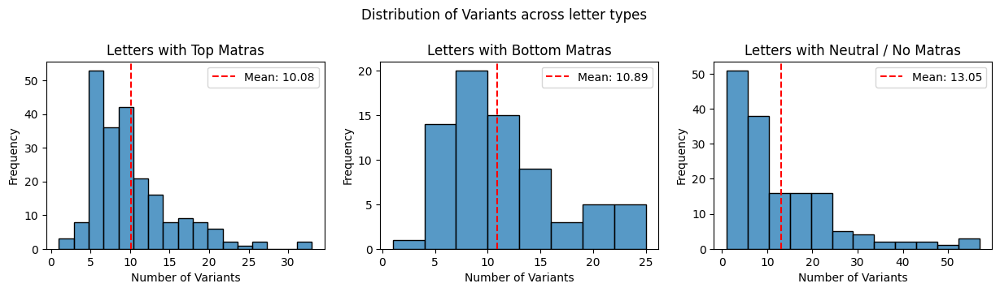

In [67]:
from numpy import mean


plt.figure(figsize=(15,3))
plt.suptitle("Distribution of Variants across letter types", y=1.1)
plt.subplot(1,3,1), sns.histplot(letter_copy_dist[0]), plt.xlabel("Number of Variants"), plt.ylabel("Frequency"), plt.title("Letters with Top Matras"), plt.axvline(mean(letter_copy_dist[0]), color='r', linestyle='--', label=f'Mean: {mean(letter_copy_dist[0]):.2f}'), plt.legend()
plt.subplot(1,3,2), sns.histplot(letter_copy_dist[1]), plt.xlabel("Number of Variants"), plt.ylabel("Frequency"), plt.title("Letters with Bottom Matras"), plt.axvline(mean(letter_copy_dist[1]), color='r', linestyle='--', label=f'Mean: {mean(letter_copy_dist[1]):.2f}'), plt.legend()
plt.subplot(1,3,3), sns.histplot(letter_copy_dist[2]), plt.xlabel("Number of Variants"), plt.ylabel("Frequency"), plt.title("Letters with Neutral / No Matras"), plt.axvline(mean(letter_copy_dist[2]), color='r', linestyle='--', label=f'Mean: {mean(letter_copy_dist[2]):.2f}'), plt.legend()
plt.show()

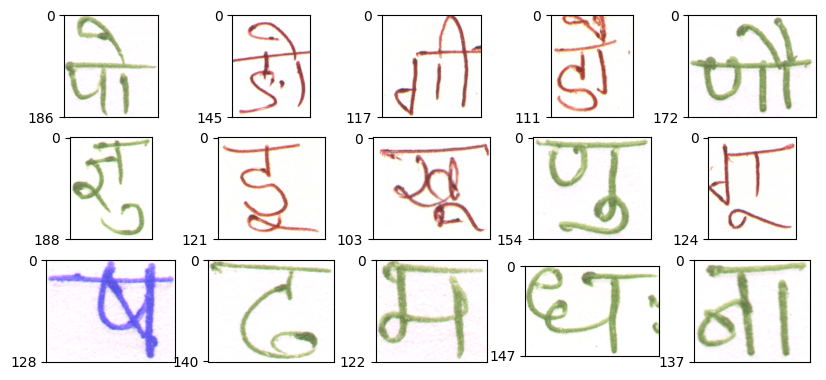

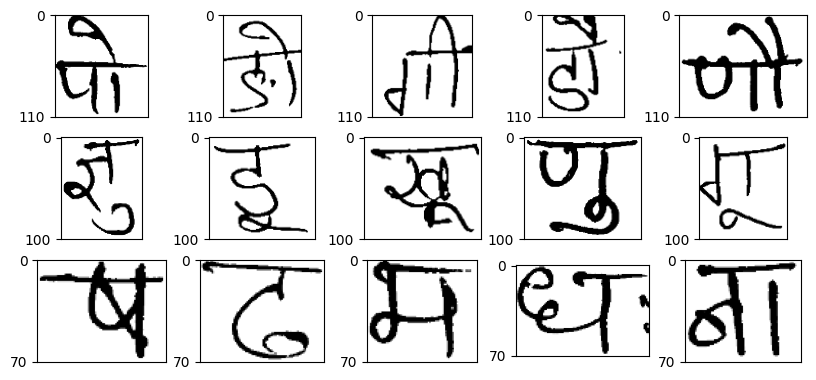

In [71]:
classes = [mode1_stats, mode2_stats, mode3_stats]

cols = 5
rows = 3
seed = 69

plt.figure(plt.figure(figsize=(2 * cols, 1.5 * rows)))

np.random.seed(seed)

for row in range(rows):
    for col in range(cols):
        randImgPath = classes[row]["Path"][np.random.randint( 0, len(classes[row]), )]
        img = cv2.imread(randImgPath, 1)
        plt.subplot(3, cols, row * cols + col + 1), plt.imshow(img), plt.xticks([]), plt.yticks([0, img.shape[0]])

np.random.seed(seed)

plt.figure(plt.figure(figsize=(2 * cols, 1.5 * rows)))
for row in range(rows):
    for col in range(cols):
        h = 70
        if(row == 0): h = 110
        if(row == 1): h = 100
        randImgPath = classes[row]["Path"][np.random.randint( 0, len(classes[row]), )]
        img = cv2.imread(randImgPath, 0)
        img = gaussBlur(img, 3)
        img = 255 * (1 - binarize(img, "THRESH_OTSU"))
        th = img.shape[0]
        tw = img.shape[1]
        f = th/h
        newSize = (int(tw/f), h)
        img = cv2.resize(img, newSize)
        plt.subplot(3, cols, row * cols + col + 1), plt.imshow(img, cmap="gray"), plt.xticks([]), plt.yticks([0, img.shape[0]])

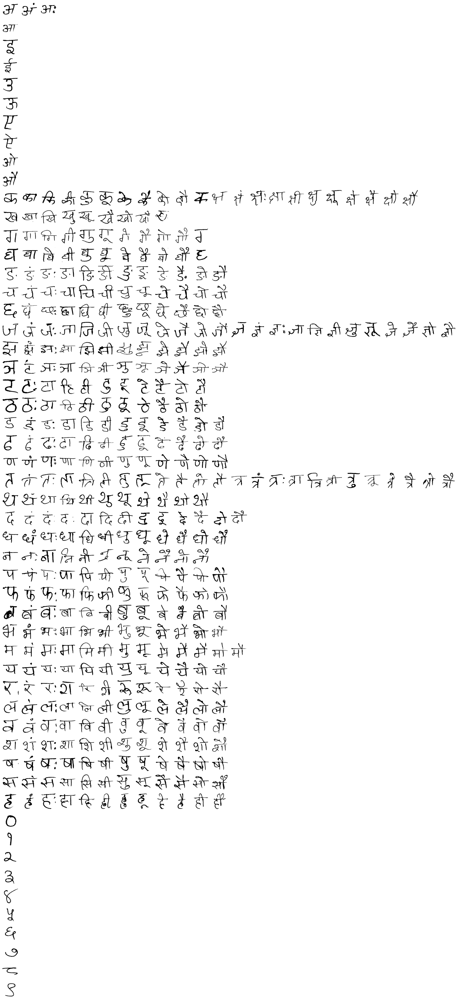

445


In [ ]:
import os
import random
import matplotlib.pyplot as plt
import cv2

# Step 1: List all folders in the source path and group them by type
src_path = "./ProcessedCALAM"
folders = [f for f in os.listdir(src_path) if os.path.isdir(os.path.join(src_path, f))]

# Group folders by type
grouped_folders = {}
for folder in folders:
    folder_type = folder.split('_')[0]  # Extract type from folder name
    if folder_type not in grouped_folders:
        grouped_folders[folder_type] = []
    grouped_folders[folder_type].append(folder)

# Find the maximum group size
max_cols = max(len(folder_list) for folder_list in grouped_folders.values())
count = 0
# Step 2: Display images grouped by type in a grid with the same number of columns
plt.figure(figsize=(1 * max_cols, 1 * len(grouped_folders)))  # Adjust figure size

for row_idx, (folder_type, folder_list) in enumerate(grouped_folders.items()):
    for col_idx in range(max_cols):
        plt.subplot(len(grouped_folders), max_cols, row_idx * max_cols + col_idx + 1)
        
        if col_idx < len(folder_list):
            folder = folder_list[col_idx]
            folder_path = os.path.join(src_path, folder).replace("\\", "\\\\").replace("/", "\\\\")
            img_files = [f for f in os.listdir(folder_path) if os.path.isfile(os.path.join(folder_path, f))]
            count += 1
            random_img = random.choice(img_files)
            img_path = os.path.join(folder_path, random_img)
            img = cv2.imread(img_path)
            img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)  # Convert to RGB for correct color display
            
            plt.imshow(img)
        else:
            # Empty subplot for alignment
            plt.gca().set_visible(False)
        
        plt.axis('off')  # Turn off axis

plt.show()
print(count)

#### Detect Shirorekha v2

In [91]:
def detect_shirorekha(img, angle_tolerance=10, threshold=10, minLineLength=12, maxLineGap=5):


    # Load the image
    if(type(img) == str):
        image = cv2.imread(img, cv2.IMREAD_GRAYSCALE)
    else:
        image = img

    # Apply binary thresholding
    _, binary_image = cv2.threshold(image, 128, 255, cv2.THRESH_BINARY_INV)

    # Apply morphological closing to connect components
    kernel = np.ones((3, 3), np.uint8)
    closed_image = cv2.morphologyEx(binary_image, cv2.MORPH_CLOSE, kernel)

    # Detect edges using Canny edge detector
    edges = cv2.Canny(closed_image, 50, 150, apertureSize=3)

    # Detect lines using Hough Line Transform
    lines = cv2.HoughLinesP(edges, 1, np.pi / 180, threshold=threshold, minLineLength=minLineLength, maxLineGap=maxLineGap)

    useless = False
    best_line = None  # Initialize best_line to None

    # Draw the detected Shirorekha on the original image
    image_with_shirorekha = cv2.cvtColor(image, cv2.COLOR_GRAY2BGR)
    if lines is not None:
        valid_lines = []
        for line in lines:
            x1, y1, x2, y2 = line[0]
            angle = np.degrees(np.arctan2(y2 - y1, x2 - x1))  # Calculate the angle of the line

            # Check if the line is close to horizontal within the angle tolerance
            if -angle_tolerance <= angle <= angle_tolerance:
                valid_lines.append(line)

        # Filter out lines that are in the lower half or the top 20 pixels of the image
        valid_lines = [line for line in valid_lines if min(line[0][1], line[0][3]) < image.shape[0] // 2]
        if(image.shape[0] == 110):
            valid_lines = [line for line in valid_lines if 30 <= min(line[0][1], line[0][3])]

        if valid_lines:
            # Sort the valid lines by the y-coordinate (height) and then by length
            valid_lines.sort(key=lambda l: (min(l[0][1], l[0][3]), -(l[0][2] - l[0][0])))

            # Choose the highest valid line (with smallest y-coordinate)
            best_line = valid_lines[0]
        else:
            # print(f"No valid Shirorekha lines detected - {image_path}")
            useless = True
    else:
        # print(f"No lines detected - {image_path}")
        useless = True

    # Draw the selected Shirorekha on the original image
    image_with_shirorekha = cv2.cvtColor(image, cv2.COLOR_GRAY2BGR)
    if best_line is not None:
        x1, y1, x2, y2 = best_line[0]
        cv2.line(image_with_shirorekha, (x1, y1), (x2, y2), (255, 0, 0), 2)
        if(image.shape[0] == 110): cv2.line(image_with_shirorekha, (x1, y1), (x2, y2), (0, 255, 0), 2)
    else:
        # print(f"No appropriate Shirorekha found - {image_path}")
        useless = True

    return image_with_shirorekha, ((x1, y1), (x2, y2)), useless

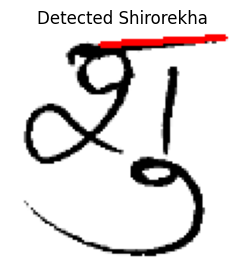

In [92]:
# Example usage
# C:\Users\devbh\OneDrive\Desktop\College\Sem 5\Projects\Hindi_Handwriting_Gen\CALAM_Dataset\ProcessedCALAM\091A_0903\54_((49, 7), (104, 1)).png
image_path = "./ProcessedCALAM/0936_0941/60_((39, 5), (92, 2)).png"
img, coord, useless = detect_shirorekha(image_path)

# Display the result
plt.figure(figsize=(6, 3))
plt.title("Detected Shirorekha")
plt.imshow(img)
plt.axis('off')
plt.show()

In [78]:
import os
import matplotlib.pyplot as plt
import cv2

# Step 1: List all folders in the source path and group them by type
src_path = "./ProcessedCALAM"
folders = [f for f in os.listdir(src_path) if os.path.isdir(os.path.join(src_path, f))]

# Group folders by type
grouped_folders = {}
for folder in folders:
    folder_type = folder.split('_')[0]  # Extract type from folder name
    if folder_type not in grouped_folders:
        grouped_folders[folder_type] = []
    grouped_folders[folder_type].append(folder)

# Count total images to determine the grid size
total_images = sum(len(os.listdir(os.path.join(src_path, folder))) for folder in folders)
max_cols = max(len(folder_list) for folder_list in grouped_folders.values())
total_rows = total_images // max_cols + (total_images % max_cols != 0)

# Step 2: Display images grouped by type in a grid with the same number of columns
plt.figure(figsize=(2 * max_cols, 2 * total_rows))  # Adjust figure size

uselessList = []
image_idx = 1
img_count = 0

for row_idx, (folder_type, folder_list) in enumerate(grouped_folders.items()):
    for folder in folder_list:
        folder_path = os.path.join(src_path, folder)
        img_files = [f for f in os.listdir(folder_path) if os.path.isfile(os.path.join(folder_path, f))]

        for img_file in img_files:
            img_path = os.path.join(folder_path, img_file)
            img_count += 1

            img, coordinates, isUseless = detect_shirorekha(img=img_path, angle_tolerance=10, 
                                                     threshold=10, minLineLength=12, maxLineGap=5)
            
            plt.subplot(total_rows, max_cols, image_idx)
            plt.imshow(img)
            if isUseless:
                uselessList.append(img_path)
            
            plt.axis('off')  # Turn off axis
            image_idx += 1

plt.show()

print(f"{len(uselessList)} of {img_count} images are useless")

282 of 5007 images are useless


#### Rest

(<Axes: xlabel='Aspect Ratio', ylabel='Count'>,
 <Axes: xlabel='Aspect Ratio', ylabel='Count'>)

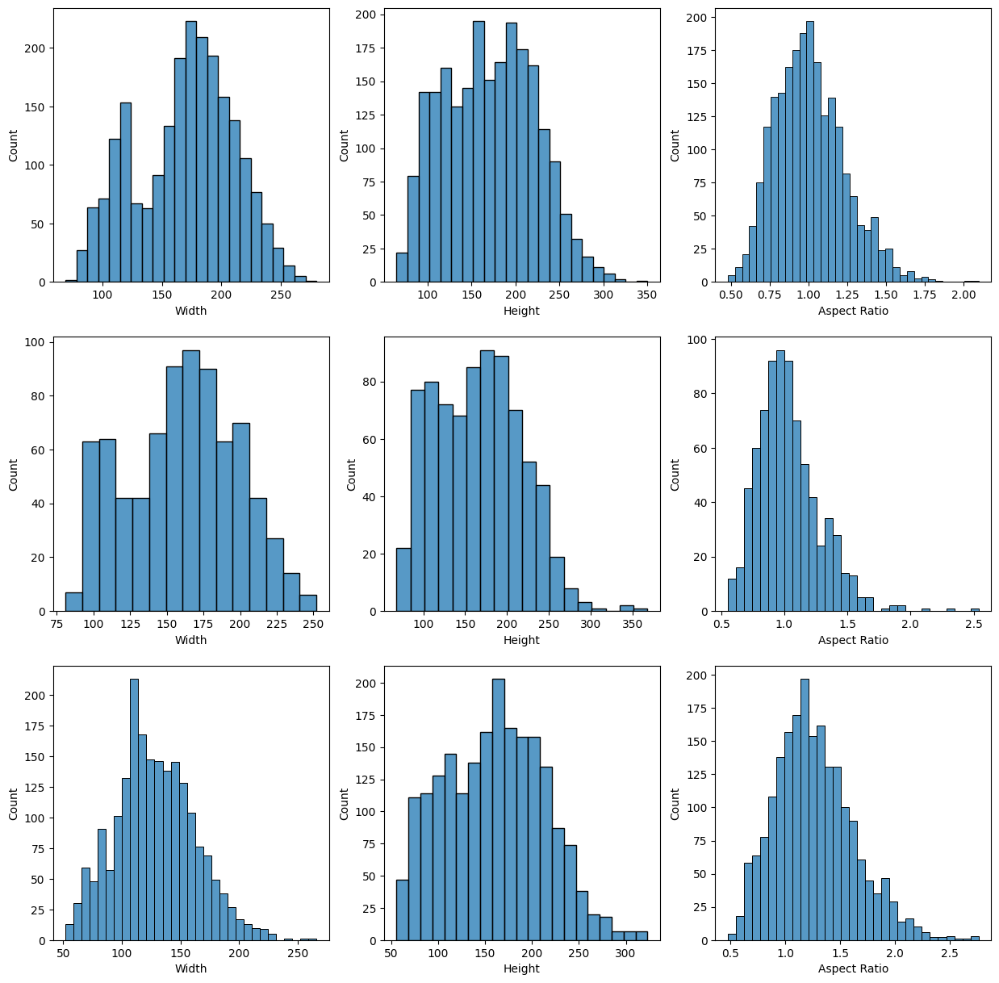

In [125]:
plt.figure(figsize=(15,15))
plt.subplot(3,3,1), sns.histplot(mode1_stats["Width"])
plt.subplot(3,3,2), sns.histplot(mode1_stats["Height"])
plt.subplot(3,3,3), sns.histplot(mode1_stats["Aspect Ratio"])

plt.subplot(3,3,4), sns.histplot(mode2_stats["Width"])
plt.subplot(3,3,5), sns.histplot(mode2_stats["Height"])
plt.subplot(3,3,6), sns.histplot(mode2_stats["Aspect Ratio"])

plt.subplot(3,3,7), sns.histplot(mode3_stats["Width"])
plt.subplot(3,3,8), sns.histplot(mode3_stats["Height"])
plt.subplot(3,3,9), sns.histplot(mode3_stats["Aspect Ratio"])

#### answer these questions
- how many unique characters?
- how many total characters with copies
- display all charcters in grid format

## PreProcessing

#### Preprocessing methods

gaussian blur

In [68]:
def gaussBlur(img, blur_rad = 3):
    shape = (blur_rad, blur_rad)
    img = cv2.GaussianBlur(img, shape, 0)
    return img

binarization

In [69]:
def binarize(img, method = 'THRESH_OTSU'):
    if method == 'THRESH_BINARY':
        img = cv2.threshold(img, 210, 1, cv2.THRESH_BINARY)[1]
    elif method == 'THRESH_BINARY_INV':
        img = cv2.threshold(img, 210, 1, cv2.THRESH_BINARY_INV)[1]
    elif method == 'THRESH_OTSU':
        img = cv2.threshold(img, 0, 1, cv2.THRESH_BINARY_INV + cv2.THRESH_OTSU)[1]
    elif method == 'ADAPTIVE_GAUSSIAN':
        img = 1 - cv2.adaptiveThreshold(img, 1, cv2.ADAPTIVE_THRESH_GAUSSIAN_C, cv2.THRESH_BINARY, 11, 2)
    elif method == 'ADAPTIVE_MEAN':
        img = 1 - cv2.adaptiveThreshold(img, 1, cv2.ADAPTIVE_THRESH_MEAN_C, cv2.THRESH_BINARY, 11, 2)
    return img

shirorekha detection

In [70]:
def detect_shirorekha(img, angle_tolerance=10, threshold=10, minLineLength=12, maxLineGap=5):


    # Load the image
    if(type(img) == str):
        image = cv2.imread(img, cv2.IMREAD_GRAYSCALE)
    else:
        image = img

    # Apply binary thresholding
    _, binary_image = cv2.threshold(image, 128, 255, cv2.THRESH_BINARY_INV)

    # Apply morphological closing to connect components
    kernel = np.ones((3, 3), np.uint8)
    closed_image = cv2.morphologyEx(binary_image, cv2.MORPH_CLOSE, kernel)

    # Detect edges using Canny edge detector
    edges = cv2.Canny(closed_image, 50, 150, apertureSize=3)

    # Detect lines using Hough Line Transform
    lines = cv2.HoughLinesP(edges, 1, np.pi / 180, threshold=threshold, minLineLength=minLineLength, maxLineGap=maxLineGap)

    useless = False
    best_line = None  # Initialize best_line to None

    # Draw the detected Shirorekha on the original image
    image_with_shirorekha = cv2.cvtColor(image, cv2.COLOR_GRAY2BGR)
    if lines is not None:
        valid_lines = []
        for line in lines:
            x1, y1, x2, y2 = line[0]
            angle = np.degrees(np.arctan2(y2 - y1, x2 - x1))  # Calculate the angle of the line

            # Check if the line is close to horizontal within the angle tolerance
            if -angle_tolerance <= angle <= angle_tolerance:
                valid_lines.append(line)

        # Filter out lines that are in the lower half or the top 20 pixels of the image
        valid_lines = [line for line in valid_lines if min(line[0][1], line[0][3]) < image.shape[0] // 2]
        if(image.shape[0] == 110):
            valid_lines = [line for line in valid_lines if 30 <= min(line[0][1], line[0][3])]

        if valid_lines:
            # Sort the valid lines by the y-coordinate (height) and then by length
            valid_lines.sort(key=lambda l: (min(l[0][1], l[0][3]), -(l[0][2] - l[0][0])))

            # Choose the highest valid line (with smallest y-coordinate)
            best_line = valid_lines[0]
        else:
            # print(f"No valid Shirorekha lines detected - {image_path}")
            useless = True
    else:
        # print(f"No lines detected - {image_path}")
        useless = True

    # Draw the selected Shirorekha on the original image
    image_with_shirorekha = cv2.cvtColor(image, cv2.COLOR_GRAY2BGR)
    if best_line is not None:
        x1, y1, x2, y2 = best_line[0]
        cv2.line(image_with_shirorekha, (x1, y1), (x2, y2), (255, 0, 0), 2)
        if(image.shape[0] == 110): cv2.line(image_with_shirorekha, (x1, y1), (x2, y2), (0, 255, 0), 2)
    else:
        # print(f"No appropriate Shirorekha found - {image_path}")
        useless = True

    return image_with_shirorekha, ((x1, y1), (x2, y2)), useless

#### Binarize, Blur and Resize images

define heights and segregated folder codes for matras

In [82]:
upHeight = 110
lowHeight = 100
height = 70
upString = ['908', '910', '913', '914', '93F', '940', '947', '948', '94B', '94C']
lowString = ['941', '942']
numString = ['0966', '0967', '0968', '0969', '096A', '096B', '096C', '096D', '096E', '096F']
conjunct = ['091C_094D', '0915_094D', '0924_094D']

apply image binariazation, resizing and save it to the processed folder

In [83]:
src = "SegregatedCALAM"
dst = "ProcessedCALAM"

counter = 0
# for each folder in src
for folder in glob.glob(f'{src}\\*'):
    # check existence
    if os.path.isdir(folder):
        # decide img height based on class of matra
        newHeight = height
        if(folder[-3:] in upString): newHeight = upHeight
        if(folder[-3:] in lowString): newHeight = lowHeight

        
        # copy folder in dst folder
        processedPath = folder.replace(src, dst)
        if os.path.exists(processedPath):
            shutil.rmtree(processedPath) # remove if path already exists
        os.makedirs(processedPath, exist_ok=True) # then create the path

        for imgPath in glob.glob(f"{folder}\\*.png"): # for each image in src folder
            counter += 1
            img = cv2.imread(imgPath, 0) # read image
            img = gaussBlur(img, 3) # blur
            img = 255 * (1 - binarize(img, "THRESH_OTSU")) # binarize
            
            # resize all images uniformly as per predefined heights
            new_aspect_ratio = img.shape[0] / newHeight
            newSize = (int(img.shape[1] / new_aspect_ratio), newHeight)
            img = cv2.resize(img, newSize)
            _, coord, useless = detect_shirorekha(img)

            # print(folder.split("\\")[-1])
            if(folder.split("\\")[-1] in numString):
                useless = False
                coord = ((0,0),(0,0))

            if(not(useless)):
                dstPath = imgPath.replace(src, dst)
                dstPath = re.sub(r'(.*\\)([^\\]+)(\.png)', rf'\1\2_{coord}\3', dstPath)
                cv2.imwrite(dstPath, img) # save image
            else:
                continue

print and remove empty character folders

In [84]:
parent_folder = "./ProcessedCALAM"

for root, dirs, files in os.walk(parent_folder, topdown=False):
    for dir_name in dirs:
        dir_path = os.path.join(root, dir_name)
        if not os.listdir(dir_path):  # Check if the folder is empty
            print(f"Deleting empty folder: {dir_path}")
            os.rmdir(dir_path)

Deleting empty folder: ./ProcessedCALAM\0915_094D_0937_0902


#### Calculate possible word combinations

load all words from dictionary

In [2]:
data = None
with open("./Hindi.txt", "r", encoding="utf-8") as f:
    data = f.read()
data = data.split(",")
data = data[:len(data)]
len(data)

476641

load all folders containing word codes

In [9]:
charFolders = []
src = "ProcessedCALAM"
for folder in glob.glob(f'{src}\\*'):
    # check existence
    if os.path.isdir(folder):
        charFolders.append(folder.split("\\")[-1])

print(charFolders)

['0905', '0905_0902', '0905_0903', '0906', '0907', '0908', '0909', '090A', '090F', '0910', '0913', '0914', '0915', '0915_093E', '0915_093F', '0915_0940', '0915_0941', '0915_0942', '0915_0947', '0915_0948', '0915_094B', '0915_094C', '0915_094D', '0915_094D_0937', '0915_094D_0937_0903', '0915_094D_0937_093E', '0915_094D_0937_0940', '0915_094D_0937_0941', '0915_094D_0937_0942', '0915_094D_0937_0947', '0915_094D_0937_0948', '0915_094D_0937_094B', '0915_094D_0937_094C', '0916', '0916_093E', '0916_093F', '0916_0941', '0916_0942', '0916_0948', '0916_094B', '0916_094C', '0916_094D', '0917', '0917_093E', '0917_093F', '0917_0940', '0917_0941', '0917_0942', '0917_0947', '0917_0948', '0917_094B', '0917_094C', '0917_094D', '0918', '0918_093E', '0918_093F', '0918_0940', '0918_0941', '0918_0942', '0918_0947', '0918_0948', '0918_094B', '0918_094C', '0918_094D', '0919', '0919_0902', '0919_0903', '0919_093E', '0919_093F', '0919_0940', '0919_0941', '0919_0942', '0919_0947', '0919_0948', '0919_094B', '091

find words that can be constructed with the current letter vocabulary

In [10]:
conjunct = ['091C_094D', '0915_094D', '0924_094D']

wordComb = []
approved_words = []

# for each word in dict
for word in data:
    hindi_word = word
    charList = []

    if(len(word) <= 31): # set word length limit to 31 characters (including matras)
        word = word.replace('\n', '')
        characters = []
        for ch in word: # convert letters to unicode representations and store
            characters.append(('0' + hex(ord(ch))[2:]).upper())
        
        check = True
        i = 0
        # for each unicode character representation of current word
        while check and i < len(characters):
            check = False
            word = ''

            # add join current and next char
            if i < len(characters) - 1:
                word = characters[i] + '_' + characters[i+1]
            
            # if half (halant) letter exists in combination to next character
            if word in conjunct and i < len(characters) - 2:
                word2 = word + '_' + characters[i+2] # join with next character to check for more possibilities
                if word2 in charFolders: # if the current handwritten character combination exists
                    # if still not reached end and concatenation of next character exists in folder
                    if i < len(characters) - 3 and word2 + '_' + characters[i+3] in charFolders:
                        charList.append(word2 + '_' + characters[i+3]) # add to charlist
                        check = True
                        i += 4
                    else: # add the next character as a seperate sequence element
                        charList.append(word2)
                        check = True
                        i += 3
            
            # above if condition only adds char to charlist if that subsequence is found in folder names, and so check is set to true
            # below, if check is false, only then we fall back to the word (character[i] + character[i+1])
            # or character (character[i]) combination addition to charlist
            
            # check if word (character[i] + character[i+1]) combination exists and adds to charlist
            # and sets flag to true
            if check == False and word in charFolders:
                check = True
                charList.append(word)
                i += 2
            
            # if word also does not exist, then only the character is added to charlist given that it exists in the folder
            if check == False and characters[i] in charFolders:
                check = True
                charList.append(characters[i])
                i += 1
        
        # appends all information for that word as well as the annotated word
        if check == True:
            wordComb.append((charList, word))
            approved_words.append(hindi_word)

print('Num. of Unique Possible Words: ', len(wordComb))

Num. of Unique Possible Words:  205541


create array of imagepaths for each word's charlist along with its annotations (including copies of same word with random letter variants)

In [11]:
dst = 'ProcessedCALAM/'
copies = 1
charImgs_Word = []
annotations = []
for i, (charList, gt) in enumerate(wordComb):
    for j in range(copies):
        charImgs = []
        for char in charList:
            dir = dst + char + '/'
            file = os.path.join(dir, random.choice(os.listdir(dir)))
            charImgs.append(file)
        charImgs_Word.append((charImgs, gt))
        annotations.append(approved_words[i])

# use charImgs_Word, approved_words

#### Generated images by concatenating hindi characters

In [12]:
# Initialize dst folder for generated handwritten word images

dst = "WordImages"
annotation_file = "annotations.txt"

if os.path.exists(dst):
    shutil.rmtree(dst)
os.mkdir(dst)
with open(annotation_file, 'w+', encoding = 'utf-8') as f:
    f.writelines([x+"\n" for x in annotations])

In [13]:
def getSeqPositions(paths):
    # paths = ['ProcessedCALAM/092A/26_((28, 6), (61, 4)).png',
    # 'ProcessedCALAM/0930_093F/53_((91, 31), (147, 30)).png',
    # 'ProcessedCALAM/0939_093E/18_((25, 6), (67, 1)).png',
    # 'ProcessedCALAM/0930/68_((16, 8), (66, 1)).png',
    # 'ProcessedCALAM/0923/185_((12, 1), (38, 5)).png']

    heights = [plt.imread(path).shape[0] for path in paths]
    line_points = [[x[1] for x in eval(path.split(".")[0].split("_")[-1])] for path in paths]

    curr_min, curr_max = 0, heights[0]
    y_coords = [[curr_min, curr_max]]
    for i in range(1, len(heights)):
        new_min = line_points[i-1][1] - line_points[i][0]
        new_max = new_min + heights[i]

        line_points[i][1] += new_min

        y_coords.append([new_min, new_max])

        curr_min, curr_max = min(curr_min, new_min), max(curr_max, new_max)

    img_height = curr_max - curr_min

    for i in y_coords:
        i[0] -= curr_min
        i[1] -= curr_min

    return (img_height, y_coords)

Image with calculations<br>
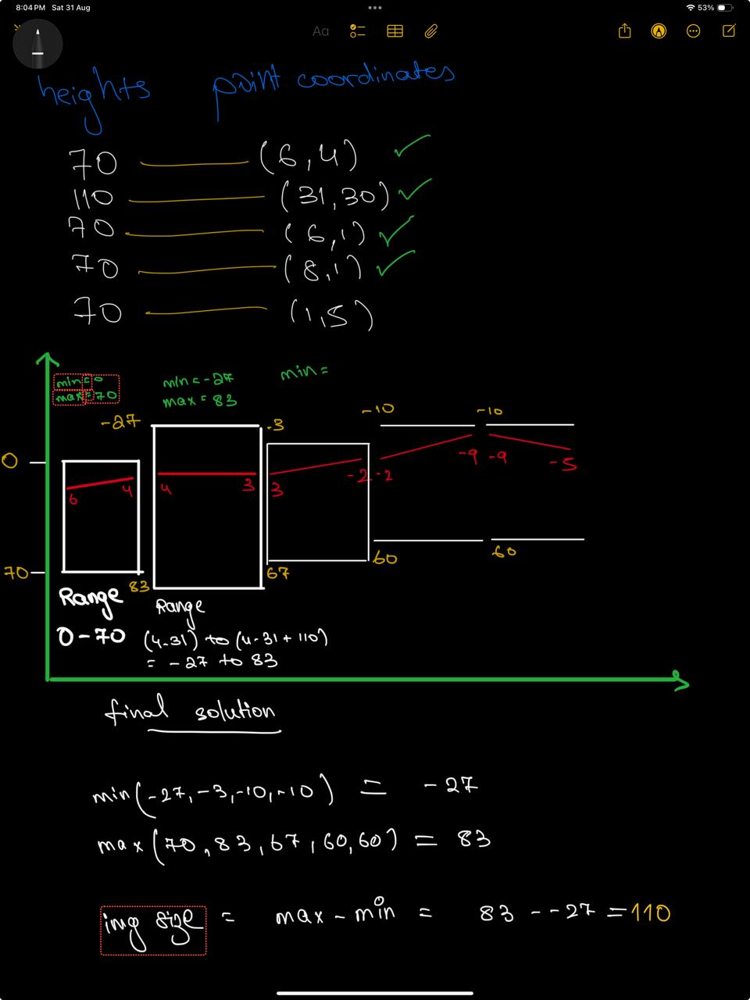

In [14]:
upHeight = 110
lowHeight = 100
height = 70
count = 0

for tup in charImgs_Word:
    count += 1
    # img matrices for all letters for the word
    imgs = [cv2.imread(file, 0) for file in tup[0]]

    if len(imgs) == 0: # skip if no letters
        continue
        
    # initialize word dims
    h, letterCoords = getSeqPositions(tup[0]) # sample output - (110, [[27, 97], [0, 110], [24, 94], [17, 87], [17, 87]])
    topPresent = False
    botPresent = False
    width = 0
    
    # set word dim booleans based letter sizes
    for i in range(len(imgs)):
        if imgs[i].shape[0] == upHeight:
            topPresent = True
        elif imgs[i].shape[0] == lowHeight:
            botPresent = True
        imgs[i] = np.uint64(1 - imgs[i]/255)
        width += imgs[i].shape[1]*0.85 # 85% independent letter space and 15% overlap for middle letters
    # 15% start and end letter width if 2 or more letters in word
    if len(imgs) >= 2:
        width += imgs[0].shape[1]*0.15 + imgs[-1].shape[1]*0.15
    else: # only 15% width for single letter = 100% letter width
        width += imgs[0].shape[1]*0.15
    width = int(width) + 1 # round off

    # generate image
    result = np.uint64(np.zeros((h, width))) # initialize word dims
    startHeight, endHeight = letterCoords[0][0], letterCoords[0][1]
    result[startHeight:endHeight, 0:imgs[0].shape[1]] = np.bitwise_or(result[startHeight:endHeight, 0:imgs[0].shape[1]], imgs[0]) # initialize first letter
    i = 1
    index = int(0.85*imgs[i-1].shape[1]) # 15% overlap index to add next letter
    while i < len(imgs): # incrementally go on adding consequent letters
        width = imgs[i].shape[1]
        startHeight, endHeight = letterCoords[i][0], letterCoords[i][1]
        result[startHeight:endHeight, index:index+width] = np.bitwise_or(result[startHeight:endHeight, index:index+width], imgs[i])
        index += int(0.85*imgs[i].shape[1])
        i += 1
    
    result = 255 - result*255
    cv2.imwrite(dst + '/' + str(count) + '.png', result)